# Notebook which takes GFS model data, filteres it to relevant avalanche regions and outputs it to regional .netcdf files

### uses env pangeo_small

### Notes: At least on my machine I found a few things were affecting the performance and stability of the disk operations
1. The Dask based operations either in Xarray or directly in Dask (using local cluster) where less efficient than just using joblib parallel.  So I tend ot use Xarray in single process mode and do the parallel work with joblib
2. The netcdf write operation wasn't very resiliant when running in parallel so I generally had to both limit any operations which were writing netcdf files to max of 4 cores as well as do some error checking on the files.

In [2]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [3]:
import xarray as xr
import matplotlib.pyplot as plt
import datetime as dt
import pandas as pd
import salem
import numpy as np
import geopandas as gpd
#import cfgrib
import datetime
from joblib import Parallel, delayed
import os
import time

### Currently designed to run one pass through this notebook per season per state

# Data structure

OAPMLData/

    1.RawWeatherData/
        gfs/
            <season>/
                /<state or country>/
    2.GFSDaily(x)Interpolation)/
    3.GFSFiltered(x)Interpolation)

## These parameters need to be set

In [4]:
season = '15-16'
state = 'Washington'
snow_start_date = '2015-11-01'

interpolate = 1 #interpolation factor: whether we can to augment the data through lat/lon interpolation; 1 no interpolation, 4 is 4x interpolation

data_root = '/media/scottcha/E1/Data/OAPMLData/'
#data_root = '/media/scottcha/E1/Data/Temp/Tutorial/'

n_jobs = 4 #number of parallel processes, this processing is IO bound so don't set this too high

In [5]:
if state == 'Washington':
    statePath = 'Washington'
else:
    statePath = 'ColoradoUtah' #the nc file which contains the weather data contains both utah and colorado

#make sure these are correct, but these generally don't need to change
#Path to USAvalancheRegions.geojson in this repo
region_path = '../../Data' 
#path to the gfs netcdf files for input
dataset_path = data_root + '/1.RawWeatherData/gfs/' + season + '/' + statePath + '/'
#output path for the result of the interpolation
day_path = data_root + '2.GFSDaily' + str(interpolate) + 'xInterpolation/'+ season + '/'
    
filtered_path = data_root + '3.GFSFiltered' + str(interpolate) + 'xInterpolation/'+ season + '/'

#input file patterns as we'll read a full winter season in one pass
file_pattern1 = '00.f0[0-2]*.grib2'
file_pattern2 = '00.f0[0-2]*.nc'

p = 181
if season in ['15-16', '19-20']:
    p = 182 #leap years

date_values_pd = pd.date_range(snow_start_date, periods=p, freq="D")

In [6]:
print(dataset_path + ' Is Input Directory')
print(day_path + ' Is output directory and input to filtering')
print(filtered_path + ' Is output directory of filtering')

/media/scottcha/E1/Data/OAPMLData//1.RawWeatherData/gfs/15-16/Washington/ Is Input Directory
/media/scottcha/E1/Data/OAPMLData/2.GFSDaily1xInterpolation/15-16/ Is output directory and input to filtering
/media/scottcha/E1/Data/OAPMLData/3.GFSFiltered1xInterpolation/15-16/ Is output directory of filtering


In [7]:
#check dates end on April 30 which is the last day we support
assert(date_values_pd[-1].month == 4)
assert(date_values_pd[-1].day == 30)

In [8]:
if not os.path.exists(day_path):
    os.makedirs(day_path)

## Debug below here

In [9]:
print(dataset_path + 'gfs.0p25.' + '20151101' + file_pattern2)

/media/scottcha/E1/Data/OAPMLData//1.RawWeatherData/gfs/15-16/Washington/gfs.0p25.2015110100.f0[0-2]*.nc


In [10]:
#gfs.0p25.2015110100.f003.nc

In [11]:
'gfs.0p25.2015110100.f0[0-2]*.nc'

'gfs.0p25.2015110100.f0[0-2]*.nc'

In [4]:
ds2 = xr.open_dataset('/media/scottcha/E1/Data/Temp/Tutorial/1.RawWeatherData/grib_to_nc/test.nc')

In [5]:
ds2

<xarray.Dataset>
Dimensions:                                           (latitude: 17, longitude: 21, time: 1)
Coordinates:
  * latitude                                          (latitude) float64 45.0...
  * longitude                                         (longitude) float64 -12...
  * time                                              (time) datetime64[ns] 2...
Data variables:
    UGRD_planetaryboundarylayer                       (time, latitude, longitude) float32 ...
    VGRD_planetaryboundarylayer                       (time, latitude, longitude) float32 ...
    VRATE_planetaryboundarylayer                      (time, latitude, longitude) float32 ...
    GUST_surface                                      (time, latitude, longitude) float32 ...
    HGT_10mb                                          (time, latitude, longitude) float32 ...
    TMP_10mb                                          (time, latitude, longitude) float32 ...
    RH_10mb                                           (time, latitude, longitude) float32 ...
    UGRD_10mb                                         (time, latitude, longitude) float32 ...
    VGRD_10mb                                         (time, latitude, longitude) float32 ...
    ABSV_10mb                                         (time, latitude, longitude) float32 ...
    O3MR_10mb                                         (time, latitude, longitude) float32 ...
    HGT_20mb                                          (time, latitude, longitude) float32 ...
    TMP_20mb                                          (time, latitude, longitude) float32 ...
    RH_20mb                                           (time, latitude, longitude) float32 ...
    UGRD_20mb                                         (time, latitude, longitude) float32 ...
    VGRD_20mb                                         (time, latitude, longitude) float32 ...
    ABSV_20mb                                         (time, latitude, longitude) float32 ...
    O3MR_20mb                                         (time, latitude, longitude) float32 ...
    HGT_30mb                                          (time, latitude, longitude) float32 ...
    TMP_30mb                                          (time, latitude, longitude) float32 ...
    RH_30mb                                           (time, latitude, longitude) float32 ...
    UGRD_30mb                                         (time, latitude, longitude) float32 ...
    VGRD_30mb                                         (time, latitude, longitude) float32 ...
    ABSV_30mb                                         (time, latitude, longitude) float32 ...
    O3MR_30mb                                         (time, latitude, longitude) float32 ...
    HGT_50mb                                          (time, latitude, longitude) float32 ...
    TMP_50mb                                          (time, latitude, longitude) float32 ...
    RH_50mb                                           (time, latitude, longitude) float32 ...
    UGRD_50mb                                         (time, latitude, longitude) float32 ...
    VGRD_50mb                                         (time, latitude, longitude) float32 ...
    ABSV_50mb                                         (time, latitude, longitude) float32 ...
    O3MR_50mb                                         (time, latitude, longitude) float32 ...
    HGT_70mb                                          (time, latitude, longitude) float32 ...
    TMP_70mb                                          (time, latitude, longitude) float32 ...
    RH_70mb                                           (time, latitude, longitude) float32 ...
    UGRD_70mb                                         (time, latitude, longitude) float32 ...
    VGRD_70mb                                         (time, latitude, longitude) float32 ...
    ABSV_70mb                                         (time, latitude, longitude) float32 ...
    O3MR_70mb                                 

In [12]:
ds1 = xr.open_dataset('/media/scottcha/E1/Data/Temp/Tutorial/' + '/1.RawWeatherData/gfs/' + season + '/' + statePath + '/' + '/gfs.0p25.2016020900.f021.nc')

In [17]:
ds1

<xarray.Dataset>
Dimensions:                (initial_time0_hours: 1, lat_0: 17, lon_0: 25, lv_AMSL1: 3, lv_DBLL10: 4, lv_HTGL2: 3, lv_HTGL4: 2, lv_HTGL7: 3, lv_ISBL0: 26, lv_ISBL6: 21, lv_ISBL9: 12, lv_PVL3: 2, lv_SIGL5: 4, lv_SPDL8: 2)
Coordinates:
  * initial_time0_hours    (initial_time0_hours) datetime64[ns] 2016-02-09
  * lat_0                  (lat_0) float32 49.0 48.75 48.5 ... 45.5 45.25 45.0
  * lon_0                  (lon_0) float32 235.0 235.25 235.5 ... 240.75 241.0
  * lv_AMSL1               (lv_AMSL1) float32 1829.0 2743.0 3658.0
  * lv_HTGL2               (lv_HTGL2) float32 2.0 80.0 100.0
  * lv_HTGL4               (lv_HTGL4) float32 2.0 80.0
  * lv_HTGL7               (lv_HTGL7) float32 10.0 80.0 100.0
  * lv_ISBL0               (lv_ISBL0) float32 1000.0 2000.0 ... 97500.0 100000.0
  * lv_ISBL6               (lv_ISBL6) float32 10000.0 15000.0 ... 100000.0
  * lv_ISBL9               (lv_ISBL9) float32 1000.0 2000.0 ... 35000.0 40000.0
  * lv_PVL3                (lv_PVL3) float32 -2e-06 2e-06
Dimensions without coordinates: lv_DBLL10, lv_SIGL5, lv_SPDL8
Data variables:
    4LFTX_P0_L1_GLL0       (initial_time0_hours, lat_0, lon_0) float32 9.0 .....
    5WAVH_P0_L100_GLL0     (initial_time0_hours, lat_0, lon_0) float32 5698.2...
    ABSV_P0_L100_GLL0      (initial_time0_hours, lv_ISBL0, lat_0, lon_0) float32 ...
    APTMP_P0_L103_GLL0     (initial_time0_hours, lat_0, lon_0) float32 290.2 ...
    CAPE_P0_2L108_GLL0     (initial_time0_hours, lv_SPDL8, lat_0, lon_0) float32 ...
    CAPE_P0_L1_GLL0        (initial_time0_hours, lat_0, lon_0) float32 0.0 .....
    CIN_P0_2L108_GLL0      (initial_time0_hours, lv_SPDL8, lat_0, lon_0) float32 ...
    CIN_P0_L1_GLL0         (initial_time0_hours, lat_0, lon_0) float32 0.0 .....
    CLWMR_P0_L100_GLL0     (initial_time0_hours, lv_ISBL6, lat_0, lon_0) float32 ...
    CPOFP_P0_L1_GLL0       (initial_time0_hours, lat_0, lon_0) float32 0.0 .....
    CWAT_P0_L200_GLL0      (initial_time0_hours, lat_0, lon_0) float32 0.0 .....
    DPT_P0_L103_GLL0       (initial_time0_hours, lat_0, lon_0) float32 278.4 ...
    FLDCP_P0_L1_GLL0       (initial_time0_hours, lat_0, lon_0) float32 0.2484...
    GUST_P0_L1_GLL0        (initial_time0_hours, lat_0, lon_0) float32 0.8 .....
    HGT_P0_L100_GLL0       (initial_time0_hours, lv_ISBL0, lat_0, lon_0) float32 ...
    HGT_P0_L109_GLL0       (initial_time0_hours, lv_PVL3, lat_0, lon_0) float32 ...
    HGT_P0_L1_GLL0         (initial_time0_hours, lat_0, lon_0) float32 306.24...
    HGT_P0_L204_GLL0       (initial_time0_hours, lat_0, lon_0) float32 3244.1...
    HGT_P0_L4_GLL0         (initial_time0_hours, lat_0, lon_0) float32 3243.3...
    HGT_P0_L6_GLL0         (initial_time0_hours, lat_0, lon_0) float32 13604....
    HGT_P0_L7_GLL0         (initial_time0_hours, lat_0, lon_0) float32 11636....
    HINDEX_P0_L1_GLL0      (initial_time0_hours, lat_0, lon_0) float32 5.0 .....
    HLCY_P0_2L103_GLL0     (initial_time0_hours, lat_0, lon_0) float32 163.0 ...
    HPBL_P0_L1_GLL0        (initial_time0_hours, lat_0, lon_0) float32 198.0 ...
    ICAHT_P0_L6_GLL0       (initial_time0_hours, lat_0, lon_0) float32 13406....
    ICAHT_P0_L7_GLL0       (initial_time0_hours, lat_0, lon_0) float32 11435....
    ICEC_P0_L1_GLL0        (initial_time0_hours, lat_0, lon_0) float32 0.0 .....
    LAND_P0_L1_GLL0        (initial_time0_hours, lat_0, lon_0) float32 1.0 .....
    LFTX_P0_L1_GLL0        (initial_time0_hours, lat_0, lon_0) float32 8.3 .....
    MSLET_P0_L101_GLL0     (initial_time0_hours, lat_0, lon_0) float32 101906...
    O3MR_P0_L100_GLL0      (initial_time0_hours, lv_ISBL9, lat_0, lon_0) float32 ...
    PEVPR_P0_L1_GLL0       (initial_time0_hours, lat_0, lon_0) float32 354.03...
    PLPL_P0_2L108_GLL0     (initial_time0_hours, lat_0, lon_0) float32 69222....
    POT_P0_L104_GLL0       (initial_time0_hours, lat_0, lon_0) float32 292.0 ...
    PRES_P0_L103_GLL0      (initial_time0_hours, lat_0, lon_0) float32 97367....
    PRES_P0_L109_GLL0      (initial_ti

In [29]:
comp = ds1.isel(lv_SIGL5=0, lat_0=1, lon_0=1).to_array().values == ds1.isel(lv_SIGL5=1, lat_0=1, lon_0=1).to_array().values

In [32]:
comp

array([[[[[[[[[[[[ True,  True,  True],
                 [ True,  True,  True],
                 [ True,  True,  True]],

                [[ True,  True,  True],
                 [ True,  True,  True],
                 [ True,  True,  True]],

                [[ True,  True,  True],
                 [ True,  True,  True],
                 [ True,  True,  True]]],


               [[[ True,  True,  True],
                 [ True,  True,  True],
                 [ True,  True,  True]],

                [[ True,  True,  True],
                 [ True,  True,  True],
                 [ True,  True,  True]],

                [[ True,  True,  True],
                 [ True,  True,  True],
                 [ True,  True,  True]]]],



              [[[[ True,  True,  True],
                 [ True,  True,  True],
                 [ True,  True,  True]],

                [[ True,  True,  True],
                 [ True,  True,  True],
                 [ True,  True,  True]],

                [[

In [ ]:
ds1.stack(time_lvl=['initial_time0_hours', 'lv_AMSL1', 'lv_HTGL2', 'lv_HTGL4', 'lv_HTGL7', 'lv_ISBL0', 'lv_ISBL6', 'lv_ISBL9', 'lv_PVL3', 'lv_DBLL10', 'lv_SIGL5', 'lv_SPDL8' ])

In [54]:
list(ds1.keys())

['4LFTX_P0_L1_GLL0',
 '5WAVH_P0_L100_GLL0',
 'ABSV_P0_L100_GLL0',
 'APTMP_P0_L103_GLL0',
 'CAPE_P0_2L108_GLL0',
 'CAPE_P0_L1_GLL0',
 'CIN_P0_2L108_GLL0',
 'CIN_P0_L1_GLL0',
 'CLWMR_P0_L100_GLL0',
 'CPOFP_P0_L1_GLL0',
 'CWAT_P0_L200_GLL0',
 'DPT_P0_L103_GLL0',
 'FLDCP_P0_L1_GLL0',
 'GUST_P0_L1_GLL0',
 'HGT_P0_L100_GLL0',
 'HGT_P0_L109_GLL0',
 'HGT_P0_L1_GLL0',
 'HGT_P0_L204_GLL0',
 'HGT_P0_L4_GLL0',
 'HGT_P0_L6_GLL0',
 'HGT_P0_L7_GLL0',
 'HINDEX_P0_L1_GLL0',
 'HLCY_P0_2L103_GLL0',
 'HPBL_P0_L1_GLL0',
 'ICAHT_P0_L6_GLL0',
 'ICAHT_P0_L7_GLL0',
 'ICEC_P0_L1_GLL0',
 'LAND_P0_L1_GLL0',
 'LFTX_P0_L1_GLL0',
 'MSLET_P0_L101_GLL0',
 'O3MR_P0_L100_GLL0',
 'PEVPR_P0_L1_GLL0',
 'PLPL_P0_2L108_GLL0',
 'POT_P0_L104_GLL0',
 'PRES_P0_L103_GLL0',
 'PRES_P0_L109_GLL0',
 'PRES_P0_L1_GLL0',
 'PRES_P0_L242_GLL0',
 'PRES_P0_L243_GLL0',
 'PRES_P0_L6_GLL0',
 'PRES_P0_L7_GLL0',
 'PRMSL_P0_L101_GLL0',
 'PWAT_P0_L200_GLL0',
 'RH_P0_2L104_GLL0',
 'RH_P0_2L108_GLL0',
 'RH_P0_L100_GLL0',
 'RH_P0_L103_GLL0',
 'RH_P0_

In [100]:
ds1[list(ds1.keys())[2]].stack(time_lvl=['initial_time0_hours', 'lv_ISBL0'])#.reset_index('time_lvl')

<xarray.DataArray 'ABSV_P0_L100_GLL0' (lat_0: 17, lon_0: 25, time_lvl: 26)>
array([[[ 5.75000013e-05,  7.74000000e-05,  8.92000025e-05, ...,
         -2.80000004e-05,  3.60000013e-05,  7.49999963e-05],
        [ 5.75000013e-05,  7.72999992e-05,  8.91000018e-05, ...,
          5.40000001e-05,  1.04999999e-04,  1.13000002e-04],
        [ 5.76000020e-05,  7.72999992e-05,  8.87999995e-05, ...,
          1.25999999e-04,  1.38999996e-04,  1.38999996e-04],
        ...,
        [ 6.12000003e-05,  8.10999991e-05,  9.18000005e-05, ...,
          7.59999966e-05,  7.10000022e-05,  7.10000022e-05],
        [ 6.14000019e-05,  8.15000021e-05,  9.16999998e-05, ...,
          9.50000031e-05,  9.20000020e-05,  9.20000020e-05],
        [ 6.15000026e-05,  8.18000044e-05,  9.13999975e-05, ...,
          1.04999999e-04,  1.04999999e-04,  1.04999999e-04]],

       [[ 5.72999998e-05,  7.79999973e-05,  8.99000006e-05, ...,
         -1.17999996e-04, -1.40999997e-04, -6.90000015e-05],
        [ 5.71999990e-05,  7.78000031e-05,  8.94000041e-05, ...,
         -1.14000002e-04, -5.29999998e-05, -2.09999998e-05],
        [ 5.71999990e-05,  7.78000031e-05,  8.86999987e-05, ...,
         -1.60000000e-05,  2.70000000e-05,  1.20000004e-05],
...
          1.42999997e-04,  1.40000004e-04,  1.40000004e-04],
        [ 6.84999977e-05,  9.20000020e-05,  8.66000046e-05, ...,
          9.99999975e-05,  9.99999975e-05,  9.99999975e-05],
        [ 6.89000008e-05,  9.22000036e-05,  8.64000031e-05, ...,
          9.20000020e-05,  9.20000020e-05,  9.20000020e-05]],

       [[ 6.32000010e-05,  8.91000018e-05,  9.01000021e-05, ...,
         -6.00000021e-06, -3.99999999e-06,  3.19999999e-05],
        [ 6.36000041e-05,  8.92000025e-05,  9.01000021e-05, ...,
         -6.60000005e-05, -4.89999984e-05, -1.49999996e-05],
        [ 6.38999991e-05,  8.94000041e-05,  9.01000021e-05, ...,
         -5.89999981e-05, -4.70000014e-05, -4.60000010e-05],
        ...,
        [ 6.91000023e-05,  9.23000043e-05,  8.60000000e-05, ...,
          1.12000002e-04,  1.12000002e-04,  1.12000002e-04],
        [ 6.93999973e-05,  9.24999986e-05,  8.60000000e-05, ...,
          8.19999987e-05,  8.19999987e-05,  8.19999987e-05],
        [ 6.98000003e-05,  9.30000024e-05,  8.60000000e-05, ...,
          7.00000019e-05,  7.00000019e-05,  7.00000019e-05]]],
      dtype=float32)
Coordinates:
  * lat_0                (lat_0) float32 49.0 48.75 48.5 ... 45.5 45.25 45.0
  * lon_0                (lon_0) float32 235.0 235.25 235.5 ... 240.75 241.0
  * time_lvl             (time_lvl) MultiIndex
  - initial_time0_hours  (time_lvl) datetime64[ns] 2016-02-09 ... 2016-02-09
  - lv_ISBL0             (time_lvl) float64 1e+03 2e+03 3e+03 ... 9.75e+04 1e+05
Attributes:
    forecast_time_units:                            hours
    forecast_time:                                  21
    level_type:                                     Isobaric surface (Pa)
    parameter_template_discipline_category_number:  [ 0  0  2 10]
    parameter_discipline_and_category:              Meteorological products, ...
    grid_type:                                      Latitude/longitude
    units:                                          s-1
    long_name:                                      Absolute vorticity
    production_status:                              Operational products
    center:                                         US National Weather Servi...

In [87]:
ds1[list(ds1.keys())[0]]

<xarray.DataArray '4LFTX_P0_L1_GLL0' (initial_time0_hours: 1, lat_0: 17, lon_0: 25)>
array([[[9.      , 8.      , ..., 5.8     , 6.1     ],
        [9.8     , 8.900001, ..., 6.9     , 4.5     ],
        ...,
        [7.6     , 7.1     , ..., 4.6     , 5.4     ],
        [7.7     , 7.2     , ..., 6.2     , 5.9     ]]], dtype=float32)
Coordinates:
  * initial_time0_hours  (initial_time0_hours) datetime64[ns] 2016-02-09
  * lat_0                (lat_0) float32 49.0 48.75 48.5 ... 45.5 45.25 45.0
  * lon_0                (lon_0) float32 235.0 235.25 235.5 ... 240.75 241.0
Attributes:
    forecast_time_units:                            hours
    forecast_time:                                  21
    level:                                          0.0
    level_type:                                     Ground or water surface
    parameter_template_discipline_category_number:  [  0   0   7 193]
    parameter_discipline_and_category:              Meteorological products, ...
    grid_type:                                      Latitude/longitude
    units:                                          K
    long_name:                                      Best (4 layer) lifted index
    production_status:                              Operational products
    center:                                         US National Weather Servi...

In [91]:
vars = []
for k in list(ds1.keys()):
    v = ds1[k].attrs['long_name'].replace(' ', '')
    u = ds1[k].attrs['units'].replace(' ', '')
    coords = list(ds1[k].coords)
    if(len(coords) > 3):#we have something more than lat/lon/time
        for c in coords:        
            if c in ('initial_time0_hours', 'lat_0', 'lon_0'):                
                continue
            for l in ds1[k].coords[c].values:
                vars.append(v + '_' + c + '_' + str(int(l)) + '_' + u)
    elif len(coords) == 3: #just lat/lon/time
        vars.append(v + '_' + u)
        
        
        
    
    
    
    

In [93]:
len(vars)

315

In [21]:
#debug
ds = xr.open_mfdataset(dataset_path + 'gfs.0p25.2015110100.f006.nc', combine='nested', concat_dim='time', parallel=False)

In [22]:
ds

<xarray.Dataset>
Dimensions:                                           (latitude: 17, longitude: 21, time: 1)
Coordinates:
  * latitude                                          (latitude) float64 45.0...
  * longitude                                         (longitude) float64 -12...
  * time                                              (time) datetime64[ns] 2...
Data variables:
    UGRD_planetaryboundarylayer                       (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    VGRD_planetaryboundarylayer                       (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    VRATE_planetaryboundarylayer                      (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    GUST_surface                                      (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    HGT_10mb                                          (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    TMP_10mb                                          (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    RH_10mb                                           (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    UGRD_10mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    VGRD_10mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    ABSV_10mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    O3MR_10mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    HGT_20mb                                          (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    TMP_20mb                                          (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    RH_20mb                                           (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    UGRD_20mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    VGRD_20mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    ABSV_20mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    O3MR_20mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    HGT_30mb                                          (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    TMP_30mb                                          (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    RH_30mb                                           (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    UGRD_30mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    VGRD_30mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    ABSV_30mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    O3MR_30mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    HGT_50mb                                          (time, latitude, longitude) float32 das

In [80]:
ds

<xarray.Dataset>
Dimensions:                                           (latitude: 17, longitude: 21, time: 1)
Coordinates:
  * longitude                                         (longitude) float64 -124.0 ... -119.0
  * latitude                                          (latitude) float64 45.0 ... 49.0
  * time                                              (time) datetime64[ns] 2015-11-01T03:00:00
Data variables:
    UGRD_planetaryboundarylayer                       (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    VGRD_planetaryboundarylayer                       (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    VRATE_planetaryboundarylayer                      (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    GUST_surface                                      (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    HGT_10mb                                          (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    TMP_10mb                                          (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    RH_10mb                                           (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    UGRD_10mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    VGRD_10mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    ABSV_10mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    O3MR_10mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    HGT_20mb                                          (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    TMP_20mb                                          (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    RH_20mb                                           (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    UGRD_20mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    VGRD_20mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    ABSV_20mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    O3MR_20mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    HGT_30mb                                          (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    TMP_30mb                                          (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    RH_30mb                                           (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    UGRD_30mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    VGRD_30mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    ABSV_30mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    O3MR_30mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    HGT_50mb                                          (time, 

In [74]:
t = '20151101'

In [75]:
xr.open_mfdataset(dataset_path + 'gfs.0p25.' + t + file_pattern2, combine='nested', concat_dim='time', parallel=False) 

<xarray.Dataset>
Dimensions:                                           (latitude: 17, longitude: 21, time: 9)
Coordinates:
  * longitude                                         (longitude) float64 -124.0 ... -119.0
  * latitude                                          (latitude) float64 45.0 ... 49.0
  * time                                              (time) datetime64[ns] 2015-11-01T03:00:00 ... 2015-11-02T03:00:00
Data variables:
    UGRD_planetaryboundarylayer                       (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    VGRD_planetaryboundarylayer                       (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    VRATE_planetaryboundarylayer                      (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    GUST_surface                                      (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    HGT_10mb                                          (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    TMP_10mb                                          (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    RH_10mb                                           (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    UGRD_10mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    VGRD_10mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    ABSV_10mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    O3MR_10mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    HGT_20mb                                          (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    TMP_20mb                                          (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    RH_20mb                                           (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    UGRD_20mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    VGRD_20mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    ABSV_20mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    O3MR_20mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    HGT_30mb                                          (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    TMP_30mb                                          (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    RH_30mb                                           (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    UGRD_30mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    VGRD_30mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    ABSV_30mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    O3MR_30mb                                         (time, latitude, longitude) float32 dask.array<chunksize=(1, 17, 21), meta=np.ndarray>
    HGT_50mb                         

In [76]:
pd_t = pd.to_datetime(t)


In [77]:
 pd_t.hour

0

In [78]:
ds.time.data

array(['2015-11-01T03:00:00.000000000', '2015-11-01T06:00:00.000000000',
       '2015-11-01T09:00:00.000000000', '2015-11-01T12:00:00.000000000',
       '2015-11-01T15:00:00.000000000', '2015-11-01T18:00:00.000000000',
       '2015-11-01T21:00:00.000000000', '2015-11-02T00:00:00.000000000',
       '2015-11-02T03:00:00.000000000'], dtype='datetime64[ns]')

In [66]:
ds.time

<xarray.DataArray 'time' (time: 8)>
array([0, 1, 2, 3, 4, 5, 6, 7])
Dimensions without coordinates: time

In [65]:


resampled_ds = ds.resample(time='1d')

KeyError: 'time'

In [53]:
#opening converted netcdf files which already pivot across levels
#converts from a full forcecast file which covers many days
#to one which only covers one day in the future
#also changes the data from hourly to daily min, avg, and max values
def resample(t):
    print('On time: ' + str(t) + '\n')
    
    try:
        with xr.open_mfdataset(dataset_path + 'gfs.0p25.' + t + file_pattern2, combine='nested', concat_dim='time', parallel=False) as ds: 

            #make sure we are just getting the first 24 hours
            pd_t = pd.to_datetime(t)
            ds = ds.where(ds.time.dt.day == pd_t.day, drop=True)

            min_name_dict = {}
            max_name_dict = {}
            avg_name_dict = {}
            #print("Calcualting Variables")
            for k in ds.data_vars.keys():
                min_name_dict[k] = k + '_min'
                max_name_dict[k] = k + '_max'
                avg_name_dict[k] = k + '_avg'

            #print("Reampling")
            resampled_ds = ds.resample(time='1d')
            min_1day = resampled_ds.min().rename(min_name_dict)
            max_1day= resampled_ds.max().rename(max_name_dict)
            avg_1day = resampled_ds.mean().rename(avg_name_dict)

            #print("Merging")
            merged_ds = xr.merge([min_1day, max_1day, avg_1day])
            try:
                file = day_path + statePath + '_' + t + '.nc'
                try:
                    if os.path.exists(file):
                        os.remove(file)
                        time.sleep(1)
                except OSError as e:
                    #can likely ignore
                    print('had remove error ' + format(e))
                merged_ds.to_netcdf(file)
                merged_ds.close()
            except Exception as err:
                return day_path + statePath + '_' + t + '.nc' + ' -- ' + format(err)
                merged_ds.close()
    except OSError as err:
        print('Missing files for time: ' + t)


In [54]:
#limiting this to 4 jobs as fileio is the bottleneck
#n_jobs=4
#CPU times: user 1.11 s, sys: 551 ms, total: 1.66 s
#Wall time: 12min 22s
%time results = Parallel(n_jobs=n_jobs, backend="multiprocessing")(map(delayed(resample), date_values_pd.strftime('%Y%m%d')))

On time: 20151101

On time: 20151102
On time: 20151104
On time: 20151103





TypeError: '.dt' accessor only available for DataArray with datetime64 timedelta64 dtype or for arrays containing cftime datetime objects.

In [24]:
if not any(results):
    print('Can skip next redo cells')
else:
    print('errors in some files, go to next cell to redo those specific files')

errors in some files, go to next cell to redo those specific files


In [25]:
results

[None,
 None,
 None,
 None,
 '/media/scottcha/E1/Data/OAPMLData/2.GFSDaily1xInterpolation/19-20/Washington_20191105.nc -- NetCDF: HDF error',
 None,
 None,
 None,
 None,
 None,
 '/media/scottcha/E1/Data/OAPMLData/2.GFSDaily1xInterpolation/19-20/Washington_20191111.nc -- NetCDF: HDF error',
 None,
 None,
 '/media/scottcha/E1/Data/OAPMLData/2.GFSDaily1xInterpolation/19-20/Washington_20191114.nc -- NetCDF: HDF error',
 '/media/scottcha/E1/Data/OAPMLData/2.GFSDaily1xInterpolation/19-20/Washington_20191115.nc -- NetCDF: HDF error',
 None,
 None,
 None,
 None,
 '/media/scottcha/E1/Data/OAPMLData/2.GFSDaily1xInterpolation/19-20/Washington_20191120.nc -- NetCDF: HDF error',
 None,
 None,
 None,
 None,
 '/media/scottcha/E1/Data/OAPMLData/2.GFSDaily1xInterpolation/19-20/Washington_20191125.nc -- NetCDF: HDF error',
 None,
 None,
 None,
 None,
 None,
 '/media/scottcha/E1/Data/OAPMLData/2.GFSDaily1xInterpolation/19-20/Washington_20191201.nc -- NetCDF: HDF error',
 None,
 None,
 None,
 '/media/scot

## Next several cells demonstrate how to fix potential netcdf errors which happened in the above process

Unfortunately some of the netcdf file operations seems to be error prone so you basically have to manually check that you get through this phase

In [26]:
#get the dates for the files which had errors
redo = [x.split('_')[1].split('.')[0] for x in results if x != None]

In [27]:
#redo = ['20191103','20191106', '20191109' ]

In [17]:
#a bit of a manual process to find and fix any errors which were introduced.
#i'm not entirely sure why some of these errors are non-deterministic but
#retrying them fixes them if there are no data corruption issues
#for data corruption we just skip the data
#sometimes the file is corrupt or locked so you need to make sure its deleted first

#fix any errors
redo2 = []
for r in redo:
    b = resample(r)
    if b is not None:
        redo2.append(b)

On time: 20191105


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:31: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20200114


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:31: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20200116


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:31: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20200124


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:31: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20200314


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:31: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20200331


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:31: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


In [18]:
redo2 #if this is empty they are fixed, otherwise the error is there

['/media/scottcha/E1/Data/OAPMLData/2.GFSDaily1xInterpolation/19-20/Washington_20191105.nc -- NetCDF: HDF error',
 '/media/scottcha/E1/Data/OAPMLData/2.GFSDaily1xInterpolation/19-20/Washington_20200114.nc -- NetCDF: HDF error',
 '/media/scottcha/E1/Data/OAPMLData/2.GFSDaily1xInterpolation/19-20/Washington_20200116.nc -- NetCDF: HDF error',
 '/media/scottcha/E1/Data/OAPMLData/2.GFSDaily1xInterpolation/19-20/Washington_20200314.nc -- NetCDF: HDF error',
 '/media/scottcha/E1/Data/OAPMLData/2.GFSDaily1xInterpolation/19-20/Washington_20200331.nc -- NetCDF: HDF error']

In [14]:
#method to check if there are any file open issues with the newly output files
def check_resample(dates):
    dates_with_errors = []
    for t in dates.strftime('%Y%m%d'):
        try:
            with xr.open_dataset(day_path + statePath + '_' + t + '.nc') as file:
                file.close()
            continue                
        except: 
            dates_with_errors.append(t)
    return dates_with_errors
        

In [15]:
#another pass to try and fix any file corruption issues
redo = check_resample(date_values_pd)

In [16]:
redo

['20191105', '20200114', '20200116', '20200124', '20200314', '20200331']

In [14]:
Parallel(n_jobs=1, backend="multiprocessing")(map(delayed(resample), redo))

On time: 20181101


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20181106


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20181202


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20181203


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20181212


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20181216


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20181224


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20181229


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20181230


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20190104


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20190118


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20190202


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20190214


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20190224


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20190312


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20190313


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20190325


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20190409


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20190422


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


On time: 20190428


/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/utils.py:30: RuntimeWarning: All-NaN slice encountered
  return func(*args, **kwargs)
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: All-NaN slice encountered
  return func(*(_execute_task(a, cache) for a in args))
/home/scottcha/anaconda3/envs/pangeo_small/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


[None,
 '/media/scottcha/E1/Data/Temp/GFSDaily/18-19/ColoradoUtah_20181106.nc -- NetCDF: HDF error',
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 '/media/scottcha/E1/Data/Temp/GFSDaily/18-19/ColoradoUtah_20190214.nc -- NetCDF: HDF error',
 None,
 None,
 '/media/scottcha/E1/Data/Temp/GFSDaily/18-19/ColoradoUtah_20190313.nc -- NetCDF: HDF error',
 None,
 None,
 None,
 None]

## Now that the files are set to daily files on disk
go through them and interpolate them as a data augmentation task
this method also filters the data down to only valid avy regions as defined
in the geojson file USAvalancheRegions.geojson

In [19]:
#interpolate and filter each day 
#don't use dask for this, much faster to process the files in parallel 
#interpolate 1 is keep same, use 4 for a 4x interpolation--other values not tested
def interpolate_and_write(t):
    #Read in all avy region shapes and metadata
    regions_df = gpd.read_file(region_path + '/USAvalancheRegions.geojson')
    #filter to just the ones where we have lables for training
    training_regions_df = regions_df[regions_df['is_training']==True].copy()

    if state == 'Washington':
        training_regions_df = training_regions_df[training_regions_df['center']=='Northwest Avalanche Center']
    elif state == 'Utah':
        training_regions_df = training_regions_df[training_regions_df['center']=='Utah Avalanche Center']
    elif state == 'Colorado':
        training_regions_df = training_regions_df[training_regions_df['center']=='Colorado Avalanche Information Center']
    
    training_regions_df.reset_index(drop=True, inplace=True)
    #open files which were previously resampled to a single day per file
    try:
        with xr.open_dataset(day_path + statePath + '_' + t + '.nc') as tmp_ds: 
            #tmp_ds = merged_ds.sel(time=t)
            print('On time: ' + str(t))

            new_lon = np.linspace(tmp_ds.longitude[0], tmp_ds.longitude[-1], tmp_ds.dims['longitude'] * interpolate)
            new_lat = np.linspace(tmp_ds.latitude[0], tmp_ds.latitude[-1], tmp_ds.dims['latitude'] * interpolate)
            interpolated_ds = tmp_ds.interp(latitude=new_lat, longitude=new_lon)
                
            subsets = []
            filenames = []
            errors = []
            redo_date = []
            date = tmp_ds.time.dt.strftime('%Y%m%d').values[0]
            for _, row in training_regions_df.iterrows():
                #print("Calculating region: " + row['name'])
                f = filtered_path + 'Region_' + row['name'] + '_' + date + '.nc'
                try:
                    if interpolate == 1:
                        tmp_subset = interpolated_ds.salem.subset(geometry=row['geometry'])
                    else:
                        tmp_subset = interpolated_ds.salem.subset(geometry=row['geometry']).salem.roi(geometry=row['geometry'])
                except ValueError:
                    errors.append('Value Error: Ensure the correct training regions have been provided')

                    continue

                try:                
                    tmp_subset.to_netcdf(f)
                except Exception as err:                                
                    os.remove(f)
                    errors.append(f + ' -- ' + format(err))
                    redo_date.append(date)
                    continue
    except OSError as err:
        print('Missing files for time: ' + t + 'with error ' + format(err))
        return None

    return (errors, redo_date)

In [20]:
#it seems that n_jobs > 8 introdces a lot of errors in to the netcdf write
#n_jobs = 4
#CPU times: user 1.83 s, sys: 830 ms, total: 2.66 s
#Wall time: 45min 18s
%time results = Parallel(n_jobs=4, backend="multiprocessing")(map(delayed(interpolate_and_write), date_values_pd.strftime('%Y%m%d')))

On time: 20191103
On time: 20191101
On time: 20191104
On time: 20191102
Missing files for time: 20191105with error [Errno -51] NetCDF: Unknown file format: b'/media/scottcha/E1/Data/OAPMLData/2.GFSDaily1xInterpolation/19-20/Washington_20191105.nc'
On time: 20191106
On time: 20191107
On time: 20191108
On time: 20191109
On time: 20191110
On time: 20191111
On time: 20191112
On time: 20191113
On time: 20191114
On time: 20191115
On time: 20191116
On time: 20191117
On time: 20191118
On time: 20191119
On time: 20191120
On time: 20191121
On time: 20191122
On time: 20191123
On time: 20191124
On time: 20191125
On time: 20191126
On time: 20191127
On time: 20191128
On time: 20191129
On time: 20191130
On time: 20191201
On time: 20191202
On time: 20191203
On time: 20191204
On time: 20191205
On time: 20191206
On time: 20191207
On time: 20191208
On time: 20191209
On time: 20191210
On time: 20191211
On time: 20191212
On time: 20191213
On time: 20191214
On time: 20191215
On time: 20191216
On time: 20191

In [13]:
results

[([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 None,
 None,
 None,
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),
 ([], []),


In [23]:
#individually fix any potenital file write errors
redo = ['20181103', '20181105', '20181220', '20181225', '20181226', '20190104', '20190214', '20190222', '20190224', '20190403']
#fix any errors
redo2 = []
for r in redo:
    print('on ' + r)
    a, b = interpolate_and_write(r)
    if len(b) > 0:
        redo2.append(b)

on 20181103
On time: 20181103
on 20181105
On time: 20181105
on 20181220
On time: 20181220
on 20181225
On time: 20181225
on 20181226
On time: 20181226
on 20190104
On time: 20190104
on 20190214
On time: 20190214
on 20190222
On time: 20190222
on 20190224
On time: 20190224
on 20190403
On time: 20190403


In [28]:
redo2

[['20181202']]

In [49]:
results, redo = Parallel(n_jobs=4, backend="multiprocessing")(map(delayed(interpolate_and_write), redo2))

On time: 20151102
On time: 20151114
On time: 20151115
On time: 20151113


RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

On time: 20151119


RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

On time: 20151112
On time: 20151118
On time: 20151204


RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

On time: 20151208


RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

On time: 20151104
On time: 20151107
On time: 20151116


RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

On time: 20151214


RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

On time: 20151117


RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

RuntimeError: NetCDF: HDF error

In [51]:
redo2

['20151102',
 '20151114',
 '20151113',
 '20151115',
 '20151119',
 '20151112',
 '20151118',
 '20151204',
 '20151208',
 '20151104',
 '20151107',
 '20151116',
 '20151214',
 '20151117']

In [29]:
interpolate_and_write('20181202')

On time: 20181202


([], [])

In [69]:
#another function to check that the netcdf files were all written correctly
def check_interpolate(filename):
    errors = []
    
    if filename.endswith(".nc") and filename:
        try:
            with xr.open_dataset(directory + filename) as file:
                file.close()            
        except:
            return filename

In [73]:
files

NameError: name 'files' is not defined

In [74]:
directory = '/media/scottcha/E1/Data/Temp/GFSDailyNoInterpolation/' + season + '/'
files = [x for x in os.listdir(directory) if x.split('_')[1].split('.')[1] in '.nc'] # os.listdir(directory):
redo = Parallel(n_jobs=12, backend="multiprocessing")(map(delayed(check_interpolate), files))

In [75]:
set(redo)

{None}

In [46]:
redo2 = list(set([x.split('_')[2].split('.')[0] for x in redo if 'Steamboat' in x and '2015' in x]))

# Everything below here is debug or helper code 

In [14]:
xr.open_dataset(directory + 'Region_WA Cascades East, Central_20151119.nc')

<xarray.Dataset>
Dimensions:                                               (latitude: 23, longitude: 19, time: 1)
Coordinates:
  * time                                                  (time) datetime64[ns] ...
  * latitude                                              (latitude) float64 ...
  * longitude                                             (longitude) float64 ...
Data variables:
    UGRD_planetaryboundarylayer_min                       (time, latitude, longitude) float64 ...
    VGRD_planetaryboundarylayer_min                       (time, latitude, longitude) float64 ...
    VRATE_planetaryboundarylayer_min                      (time, latitude, longitude) float64 ...
    GUST_surface_min                                      (time, latitude, longitude) float64 ...
    HGT_10mb_min                                          (time, latitude, longitude) float64 ...
    TMP_10mb_min                                          (time, latitude, longitude) float64 ...
    RH_10mb_min                                           (time, latitude, longitude) float64 ...
    UGRD_10mb_min                                         (time, latitude, longitude) float64 ...
    VGRD_10mb_min                                         (time, latitude, longitude) float64 ...
    ABSV_10mb_min                                         (time, latitude, longitude) float64 ...
    O3MR_10mb_min                                         (time, latitude, longitude) float64 ...
    HGT_20mb_min                                          (time, latitude, longitude) float64 ...
    TMP_20mb_min                                          (time, latitude, longitude) float64 ...
    RH_20mb_min                                           (time, latitude, longitude) float64 ...
    UGRD_20mb_min                                         (time, latitude, longitude) float64 ...
    VGRD_20mb_min                                         (time, latitude, longitude) float64 ...
    ABSV_20mb_min                                         (time, latitude, longitude) float64 ...
    O3MR_20mb_min                                         (time, latitude, longitude) float64 ...
    HGT_30mb_min                                          (time, latitude, longitude) float64 ...
    TMP_30mb_min                                          (time, latitude, longitude) float64 ...
    RH_30mb_min                                           (time, latitude, longitude) float64 ...
    UGRD_30mb_min                                         (time, latitude, longitude) float64 ...
    VGRD_30mb_min                                         (time, latitude, longitude) float64 ...
    ABSV_30mb_min                                         (time, latitude, longitude) float64 ...
    O3MR_30mb_min                                         (time, latitude, longitude) float64 ...
    HGT_50mb_min                                          (time, latitude, longitude) float64 ...
    TMP_50mb_min                                          (time, latitude, longitude) float64 ...
    RH_50mb_min                                           (time, latitude, longitude) float64 ...
    UGRD_50mb_min                                         (time, latitude, longitude) float64 ...
    VGRD_50mb_min                                         (time, latitude, longitude) float64 ...
    ABSV_50mb_min                                         (time, latitude, longitude) float64 ...
    O3MR_50mb_min                                         (time, latitude, longitude) float64 ...
    HGT_70mb_min                                          (time, latitude, longitude) float64 ...
    TMP_70mb_min                                          (time, latitude, longitude) float64 ...
    RH_70mb_min                                           (time, latitude, longitude) float64 ...
    UGRD_70mb_min                                         (time, latitude, longitude) float64 ...
    VGRD_70mb_min                                         (time, latitude, longitu

In [9]:
#gets the variables and long names so we can understand what the model is covering
def get_variables(ds):
    #find all variables in the data set and their descriptions
    attrib_key = 'long_name' #'GRIB_name'
    variables = []
    i = 0
    for var in list(ds.data_vars.keys()):
        variables.append((i, var,ds[var].attrs[attrib_key]))
        i += 1

    return variables

In [10]:
#list of all the variables
get_variables(ds)

[(0, 'UGRD_planetaryboundarylayer', 'U-Component of Wind'),
 (1, 'VGRD_planetaryboundarylayer', 'V-Component of Wind'),
 (2, 'VRATE_planetaryboundarylayer', 'Ventilation Rate'),
 (3, 'GUST_surface', 'Wind Speed (Gust)'),
 (4, 'HGT_10mb', 'Geopotential Height'),
 (5, 'TMP_10mb', 'Temperature'),
 (6, 'RH_10mb', 'Relative Humidity'),
 (7, 'UGRD_10mb', 'U-Component of Wind'),
 (8, 'VGRD_10mb', 'V-Component of Wind'),
 (9, 'ABSV_10mb', 'Absolute Vorticity'),
 (10, 'O3MR_10mb', 'Ozone Mixing Ratio'),
 (11, 'HGT_20mb', 'Geopotential Height'),
 (12, 'TMP_20mb', 'Temperature'),
 (13, 'RH_20mb', 'Relative Humidity'),
 (14, 'UGRD_20mb', 'U-Component of Wind'),
 (15, 'VGRD_20mb', 'V-Component of Wind'),
 (16, 'ABSV_20mb', 'Absolute Vorticity'),
 (17, 'O3MR_20mb', 'Ozone Mixing Ratio'),
 (18, 'HGT_30mb', 'Geopotential Height'),
 (19, 'TMP_30mb', 'Temperature'),
 (20, 'RH_30mb', 'Relative Humidity'),
 (21, 'UGRD_30mb', 'U-Component of Wind'),
 (22, 'VGRD_30mb', 'V-Component of Wind'),
 (23, 'ABSV_30

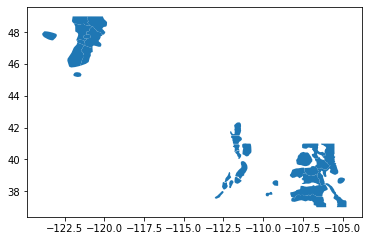

In [18]:
#review the training regions geojson
training_regions_df.geometry.plot()

In [11]:
#lon needs to be 0-360
#not needed for nc files as wgrib2 already does this conversion
#training_regions_df.loc[:,'geometry'] = training_regions_df.translate(360,0)

In [12]:
print(training_regions_df['geometry'][49])

POLYGON ((-123.437858 48.026087, -123.23695 47.974945, -123.123965 47.937633, -123.023858 47.899013, -122.994157 47.849742, -122.98579 47.806763, -122.992001 47.760979, -123.025541 47.708388, -123.062294 47.6492, -123.22403 47.49742, -123.293695 47.491354, -123.462828 47.533471, -123.497097 47.545378, -123.592243 47.588468, -123.799435 47.703362, -123.831774 47.74392, -123.894959 47.824463, -123.909086 47.889784, -123.901611 47.925517, -123.798236 48.041375, -123.773643 48.059557, -123.746519 48.065784, -123.639185 48.057868, -123.552344 48.048375, -123.437858 48.026087))


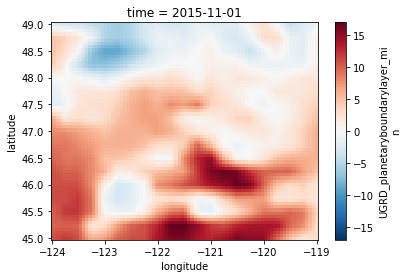

In [13]:
interpolated_ds.UGRD_planetaryboundarylayer_min[0].plot()

In [14]:
training_regions_df.head()

,name,center,center_link,timezone,center_id,state,is_training,color,link,geometry
18,Aspen Zone,Colorado Avalanche Information Center,https://avalanche.state.co.us/,America/Denver,CAIC,CO,True,#ff9933,http://avalanche.state.co.us/forecasts/backcou...,"POLYGON ((-106.91164 39.58375, -106.94518 39.5..."
19,Front Range Zone,Colorado Avalanche Information Center,https://avalanche.state.co.us/,America/Denver,CAIC,CO,True,#f4e500,http://avalanche.state.co.us/forecasts/backcou...,"POLYGON ((-105.46760 39.03134, -105.32958 39.0..."
20,Grand Mesa Zone,Colorado Avalanche Information Center,https://avalanche.state.co.us/,America/Denver,CAIC,CO,True,#ff9933,http://avalanche.state.co.us/forecasts/backcou...,"POLYGON ((-108.19110 39.28692, -108.26556 39.1..."
21,Gunnison Zone,Colorado Avalanche Information Center,https://avalanche.state.co.us/,America/Denver,CAIC,CO,True,#ff9933,http://avalanche.state.co.us/forecasts/backcou...,"POLYGON ((-106.91731 38.99704, -106.94591 39.0..."
22,North San Juan Mountains,Colorado Avalanche Information Center,https://avalanche.state.co.us/,America/Denver,CAIC,CO,True,#f4e500,http://avalanche.state.co.us/forecasts/backcou...,"POLYGON ((-106.29307 37.66569, -106.26690 37.7..."


In [20]:
%time tmp_df = interpolated_ds.salem.subset(geometry=training_regions_df['geometry'][1]).salem.roi(geometry=training_regions_df['geometry'][1])


CPU times: user 7.25 s, sys: 92.4 ms, total: 7.34 s
Wall time: 7.25 s


In [23]:
%time tmp_df2 = tmp_df.chunk({'time': -1}).interpolate_na(dim='time')

CPU times: user 5min 31s, sys: 3.16 s, total: 5min 34s
Wall time: 5min 31s


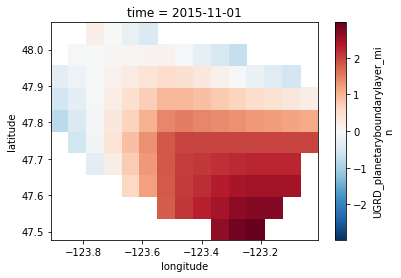

In [25]:
tmp_df2.UGRD_planetaryboundarylayer_min[0].plot()

In [46]:
#This is code to filter to all the potential world avy locations
#avy_regions_shp = salem.read_shapefile('../../GetTrainingData/CreateGlobalAvyRegions/WorldAvyRegionsShapeV2/WorldAvyRegionsV2.shp')
#avy_regions_shp.plot()
#avy_regions_shp2 = avy_regions_shp.translate(360,0)
#avy_regions_shp2[0]
#merged_filtered_ds = merged_interpolated_ds.salem.roi(geometry=avy_regions_shp2[0])
#this is the filtered snowdepths for the first day in the dataset
#merged_filtered_ds.avg_sde[100].plot()